Mount google drive.

In [6]:
from google.colab import drive
drive.mount('/content/gdrive')

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


### Importing libraries.

In [7]:
import os
import PIL
import cv2
import random
import pathlib
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

from tqdm import tqdm
from sklearn.utils import shuffle
from sklearn.cluster import KMeans
from sklearn import decomposition, datasets


import tensorflow as tf
from tensorflow.keras.backend import int_shape
from tensorflow.keras import utils, layers, Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator, img_to_array, load_img

%matplotlib inline

### Utility Functions.

In [ ]:
def plot_accuracy_loss(history, title):
  """
  Plot accuracy vs loss graphs
  
  Parameters
  ----------
  history
    The history of model.fit() of a model
  title : str
    The title of the plot
  """
  fig, axes = plt.subplots(1, 2, constrained_layout=True, figsize=(10,5))

  axes[0].plot(history['accuracy'])
  axes[0].plot(history['val_accuracy'])
  axes[0].set_title(title + ' Training vs Validation accuracy')
  axes[0].set_xlabel('Epoch')
  axes[0].set_ylabel('Accuracy')
  axes[0].legend(['train acc', 'val acc'], loc='best')

  axes[1].plot(history['loss'])
  axes[1].plot(history['val_loss'])
  axes[1].set_title(title + ' Training vs Validation loss')
  axes[1].set_xlabel('Epoch')
  axes[1].set_ylabel('Loss')
  axes[1].legend(['train loss', 'val loss'], loc='best')

  plt.show()

In [ ]:
def non_local_block(z, l, intermediate_dim = None):
  """
  Apply non-local attention on the two input layers
  
  Parameters
  ----------
  z
    The upsampled layer of the model
  l
    The middle layer of the model
  intermediate_dim : tuple
    The intermediate dimension of the matrices

  Returns
  -------
  l
    A layer with non-local attention applied on it
  """
  
  batchsize, dim1, dim2, channels = z.shape
  print("Batch size:", batchsize, "dim1:", dim1, "dim2:", dim2, "channels:", channels)

  if intermediate_dim is None:
    intermediate_dim = channels // 2

    if intermediate_dim < 1:
      intermediate_dim = 1

  f = getF(z, intermediate_dim)
  k = getK(l, intermediate_dim)
  y = getY(f, k, dim1, dim2, intermediate_dim, channels)
  
  l = layers.add([l, y], name='add_1')

  return l


def getF(input_layer, intermediate_dim, compression=2):
  """
  Compute f from the input layer
  
  Parameters
  ----------
  input_layer
    The layer on which the self-attention is applied
  intermediate_dim : tuple
    The intermediate dimension of the matrices

  Returns
  -------
  f
    A layer with self-local attention applied on it
  """

  theta = convND(input_layer, intermediate_dim, 4)
  theta = layers.Reshape((-1, intermediate_dim), name='reshape_1')(theta)

  phi = convND(input_layer, intermediate_dim, 5)
  phi = layers.Reshape((-1, intermediate_dim), name='reshape_2')(phi)

  # if compression > 1:
  #   # shielded computation
  #   phi = MaxPool1D(compression)(phi)

  f = layers.dot([theta, phi], axes=2, name='dot_1')

  size = int_shape(f)

  f = layers.Lambda(lambda z: (1. / float(size[-1])) * z, name='lambda_1')(f)

  return f

def getK(input_layer, intermediate_dim):
  """
  Compute k from the input layer
  
  Parameters
  ----------
  input_layer
    The layer to be convoluted
  intermediate_dim : tuple
    The intermediate dimension of the matrices

  Returns
  -------
  k
    A layer with convolution applied on it
  """

  k = convND(input_layer, intermediate_dim, 6)
  k = layers.Reshape((-1, intermediate_dim), name='reshape_3')(k)

  return k

def getY(f, k, dim1, dim2, intermediate_dim, channels):
  """
  Compute y from f and k
  
  Parameters
  ----------
  f
    The self-attention output of the input layer
  k
    The convoluted output of the input layer
  intermediate_dim : tuple
    The intermediate dimension of the matrices

  Returns
  -------
  y
    The output of the dot product of f and k
  """

  y = layers.dot([f, k], axes=[2,1], name='dot_2')
  y = layers.Reshape((dim1, dim2, intermediate_dim), name='reshape_4')(y)
  y = convND(y, channels, 7)

  return y

def convND(input_layer, channels, n):
  """
  Process input through convolution layers
  
  Parameters
  ----------
  input_layer
    The layer to be convoluted
  channels : int
    The dimension of the filters

  Returns
  -------
  conv
    The output of the convolution of the input layer
  """

  conv = layers.Conv2D(channels, (1,1), padding='same', use_bias=False, kernel_initializer='he_normal', name=('conv_' + str(n)))(input_layer)
  return conv

### Pair data generation

In [ ]:
# Set image directory
image_dir = "/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/"
image_list = [os.path.join(image_dir, file) for file in os.listdir(image_dir)]

# Sorting image names
image_list.sort()
image_list = np.array(image_list)

print("Sorted list:", image_list[:10])

Sorted list: ['/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-1-L.png'
 '/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-1-R.png'
 '/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-3-L.png'
 '/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-3-R.png'
 '/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-4-L.png'
 '/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-4-R.png'
 '/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-5-L.png'
 '/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-5-R.png'
 '/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_Y8-1-L.png'
 '/con

Generate Pairs

In [ ]:
def create_pairs_dataset():
  """
  Generate positive and negative pairs for the pre-training task
  
  Returns
  -------
  pairs
    A list of positive and negative pairs
  labels
    A list of labels for the generated pairs
  """

  days_count = 16
  labels = []
  pairs = []
  mice_list_types=['_A8-1-','_A8-3-','_A8-4-','_A8-5-','_Y8-1-','_Y8-2-','_Y8-3-','_Y8-4-']

  # Mice pairs generation
  for mice_type in mice_list_types:
    # Iterate forward through the days
    for i in range(days_count-1):
      for j in range(i+1, days_count):
        # Left positive pairs
        left_positive_1 = image_dir + "Day " + str(i) + mice_type + "L.png"
        left_positive_2 = image_dir + "Day " + str(j) + mice_type + "L.png"
        
        # Right positive pairs
        right_positive_1 = image_dir + "Day " + str(i) + mice_type + "R.png"
        right_positive_2 = image_dir + "Day " + str(j) + mice_type + "R.png"

        pairs.append((left_positive_1, left_positive_2))
        pairs.append((right_positive_1, right_positive_2))

        labels += [1]
        labels += [1]

    # Iterate backward through the days
    for i in reversed(range(days_count)):
      for j in reversed(range(i)):
        # Left negative pairs
        left_negative_1 = image_dir + "Day " + str(i) + mice_type + "L.png"
        left_negative_2 = image_dir + "Day " + str(j) + mice_type + "L.png"
        
        # Right negative pairs
        right_negative_1 = image_dir + "Day " + str(i) + mice_type + "R.png"
        right_negative_2 = image_dir + "Day " + str(j) + mice_type + "R.png"

        pairs.append((left_negative_1, left_negative_2))
        pairs.append((right_negative_1, right_negative_2))

        labels += [0]
        labels += [0]

  return np.array(pairs), np.array(labels).astype("float32")

In [ ]:
pairs, pair_labels = create_pairs_dataset()

# Print the total number of pairs generated
print("Total pairs:", len(pairs))
print("Shape of pairs:", pairs.shape)
print("Total labels:", len(pair_labels))
print("Shape of labels:", pair_labels.shape)

# Shuffle dataset and labels
pairs, pair_labels = shuffle(pairs, pair_labels, random_state=0)

Total pairs: 3840
Shape of pairs: (3840, 2)
Total labels: 3840
Shape of labels: (3840,)


Split the dataset

In [ ]:
# Define validation and test types
mice_val_list = ['_A8-5-R','_Y8-4-L']
mice_test_list = ['_A8-5-L','_Y8-4-R']

train_pairs = []
val_pairs = []
test_pairs = []
train_pair_labels = []
val_pair_labels = []
test_pair_labels = []

# Split the dataset into train, val and test
for i, [left, right] in enumerate(pairs):
  flag = False
  for mice in mice_val_list:
    if((mice in left) or (mice in right)):
      val_pairs.append([left,right])
      val_pair_labels.append(pair_labels[i])
      flag = True
  for mice in mice_test_list:
    if((mice in left) or (mice in right)):
      test_pair_labels.append(pair_labels[i])
      test_pairs.append([left,right])
      flag = True
  if(not flag):
    train_pair_labels.append(pair_labels[i])
    train_pairs.append([left,right])

# Print the number of items in train, val and test set
print("Training pairs and labels:", len(train_pairs), len(train_pair_labels))
print("Validation pairs and labels:", len(val_pairs), len(val_pair_labels))
print("Testing pairs and labels:", len(test_pairs), len(test_pair_labels))

Training pairs and labels: 2880 2880
Validation pairs and labels: 480 480
Testing pairs and labels: 480 480


Loading image data into mermory

In [ ]:
def pil_loader(path, target_image_shape=(224,224)):
  """
  Load individual image into memory
  
  Parameters
  ----------
  path
    The absolute path to load an image
  target_shaepe : tuple
    The dimensions of the output image

  Returns
  -------
  img
    The image loaded in the memory
  """
  with open(path, 'rb') as f:
    img = PIL.Image.open(f)
    img = img.convert('RGB')
    img = np.array(img)
    img = cv2.resize(img, target_image_shape)
    return img

def load_dataset(pairs, pair_labels):
  """
  Load the pair image dataset
  
  Parameters
  ----------
  pairs
    A list of pairs generated
  pair_labels
    The labels of pairs generated

  Returns
  -------
  left_images
    The left stack of images
  right_images
    The right stack of images
  image_labels
    The labels for the images
  """
  left_images = []
  right_images = []
  image_labels = []

  for i in range(len(pairs)):
    file_l = pathlib.Path(pairs[i][0])
    file_r = pathlib.Path(pairs[i][1])
    
    if file_l.exists() and file_r.exists():
      left_images += [pil_loader(pairs[i][0])]
      right_images += [pil_loader(pairs[i][1])]
      image_labels += [pair_labels[i]]

  return np.array(left_images), np.array(right_images), np.array(image_labels).astype('float32').reshape((-1,1))

In [ ]:
# Load images into left and right stacks and load labels
left_train, right_train, labels_train = load_dataset(train_pairs, train_pair_labels)
left_val, right_val, labels_val = load_dataset(val_pairs, val_pair_labels)
left_test, right_test, labels_test = load_dataset(test_pairs, test_pair_labels)

In [ ]:
# Print the size of images and labels
print("Train images shape (Left, Right):", left_train.shape, right_train.shape)
print("Val images shape (Left, Right):  ", left_val.shape, right_val.shape)
print("Test images shape (Left, Right): ", left_test.shape, right_test.shape)
print("Train labels shape: ", labels_train.shape)
print("Val labels shape:   ", labels_val.shape)
print("Test labels shape:  ", labels_test.shape)

Train images shape (Left, Right): (2850, 224, 224, 3) (2850, 224, 224, 3)
Val images shape (Left, Right):   (480, 224, 224, 3) (480, 224, 224, 3)
Test images shape (Left, Right):  (480, 224, 224, 3) (480, 224, 224, 3)
Train labels shape:  (2850, 1)
Val labels shape:    (480, 1)
Test labels shape:   (480, 1)


In [ ]:
# Delete unwanted list of pairs
del train_pairs, val_pairs, test_pairs, train_pair_labels, val_pair_labels, test_pair_labels

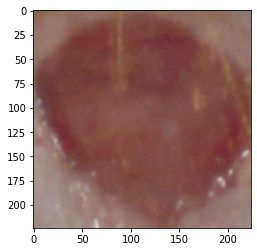

In [ ]:
# Display one image from the train set
plt.imshow(left_train[1])

### Pre-training (CNN)

In [3]:
def create_CNN_encoder(input_shape=(224, 224, 3)):
  """
  Create the CNN encoder
  
  Parameters
  ----------
  input_shape : tuple
    The shape of the input images
  
  Returns
  -------
  model
    The cnn encoder model
  """
  input_layer = layers.Input(shape=input_shape, name="input_1")

  x = layers.Conv2D(32, kernel_size=3, strides=(2,2), activation='relu', padding='same', name='conv_1')(input_layer)
  x = layers.MaxPooling2D(pool_size=(2,2), name='maxpool_1')(x)
  x = layers.BatchNormalization(name='batchnorm_1')(x)
  x = layers.Dropout(0.5, name='dropout_1')(x)
  
  x = layers.Conv2D(32, kernel_size=3, strides=(2,2), activation='relu', padding='same', name='conv_2')(x)
  x = layers.MaxPooling2D(pool_size=(2,2), name='maxpool_2')(x)
  x = layers.BatchNormalization(name='batchnorm_2')(x)
  x = layers.Dropout(0.5, name='dropout_2')(x)
  
  x = layers.Conv2D(32, kernel_size=3, strides=(2,2), activation='relu', padding='same', name='conv_3')(x)
  x = layers.MaxPooling2D(pool_size=(2,2), name='maxpool_3')(x)
  x = layers.BatchNormalization(name='batchnorm_3')(x)
  x = layers.Dropout(0.5, name='dropout_3')(x)

  x = layers.Flatten(name='flatten_1')(x)
  output_layer = layers.Dense(16, name='embedding_1')(x)

  return Model(inputs=input_layer, outputs=output_layer, name='temporal_encoder')


def create_CNN_HealNet(input_shape=(224, 224, 3)):
  """
  Create the CNN HealNet model
  
  Parameters
  ----------
  input_shape : tuple
    The shape of the input images
  
  Returns
  -------
  temporal_encoder
    The cnn temporal encoder model
  cnn_healnet
    The CNN HealNet model
  """
  temporal_encoder = create_CNN_encoder()

  left_input = layers.Input(shape=input_shape, name="left_input")
  left_encoder = temporal_encoder(left_input)

  right_input = layers.Input(shape=input_shape, name="right_input")
  right_encoder = temporal_encoder(right_input)

  x = layers.Concatenate(name='concat_1')([left_encoder, right_encoder])
  output_layer = layers.Dense(1, activation="sigmoid", name='dense_1')(x)

  cnn_healnet = Model(inputs=[left_input, right_input], outputs=output_layer, name='cnn_healnet')

  return temporal_encoder, cnn_healnet

cnn_encoder, cnn_healnet = create_CNN_HealNet()

In [4]:
# Print CNN encoder and CNN HealNet model summary
cnn_encoder.summary()
print('\n')
cnn_healnet.summary()

Model: "temporal_encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv_1 (Conv2D)             (None, 112, 112, 32)      896       
                                                                 
 maxpool_1 (MaxPooling2D)    (None, 56, 56, 32)        0         
                                                                 
 batchnorm_1 (BatchNormaliza  (None, 56, 56, 32)       128       
 tion)                                                           
                                                                 
 dropout_1 (Dropout)         (None, 56, 56, 32)        0         
                                                                 
 conv_2 (Conv2D)             (None, 28, 28, 32)        9248      
                                                  

In [5]:
def normalize_image(image):
  """
  Normalize the input image
  
  Parameters
  ----------
  image
    A image from the dataset
  
  Returns
  -------
  image
    The normalized image
  """
  image -= image.min()
  image = np.divide(image, image.max(), casting="unsafe")
  image *= 255
  
  return image

# Define training data generator
train_datagen = ImageDataGenerator(
    preprocessing_function=normalize_image
)

# Define validation data generator
val_datagen = ImageDataGenerator(
    preprocessing_function=normalize_image
)

In [ ]:
# Compile the model
cnn_healnet.compile(optimizer='Adam',
                    loss='binary_crossentropy',
                    metrics=['accuracy'])


# Model training
cnn_healnet_history = cnn_healnet.fit(
                      train_datagen.flow([left_train, right_train], labels_train),
                      validation_data=val_datagen.flow([left_val, right_val], labels_val),
                      batch_size=32,
                      epochs=25,
                      verbose=1)

# Print the test accuracy
loss, acc = cnn_healnet.evaluate([left_test, right_test], labels_test, verbose=2)
print("Accuracy: {:5.2f}%".format(100 * acc))

Epoch 1/25
90/90 [==============================] - 4s 31ms/step - loss: 0.7633 - accuracy: 0.6621 - val_loss: 0.3946 - val_accuracy: 0.8146
Epoch 2/25
90/90 [==============================] - 2s 25ms/step - loss: 0.4828 - accuracy: 0.7768 - val_loss: 0.3147 - val_accuracy: 0.8604
Epoch 3/25
90/90 [==============================] - 2s 25ms/step - loss: 0.3874 - accuracy: 0.8218 - val_loss: 0.2907 - val_accuracy: 0.8687
Epoch 4/25
90/90 [==============================] - 2s 25ms/step - loss: 0.3378 - accuracy: 0.8428 - val_loss: 0.2774 - val_accuracy: 0.8875
Epoch 5/25
90/90 [==============================] - 2s 26ms/step - loss: 0.3256 - accuracy: 0.8516 - val_loss: 0.2747 - val_accuracy: 0.9021
Epoch 6/25
90/90 [==============================] - 2s 25ms/step - loss: 0.3072 - accuracy: 0.8649 - val_loss: 0.2809 - val_accuracy: 0.8875
Epoch 7/25
90/90 [==============================] - 2s 25ms/step - loss: 0.2967 - accuracy: 0.8716 - val_loss: 0.3205 - val_accuracy: 0.8396
Epoch 8/25
90

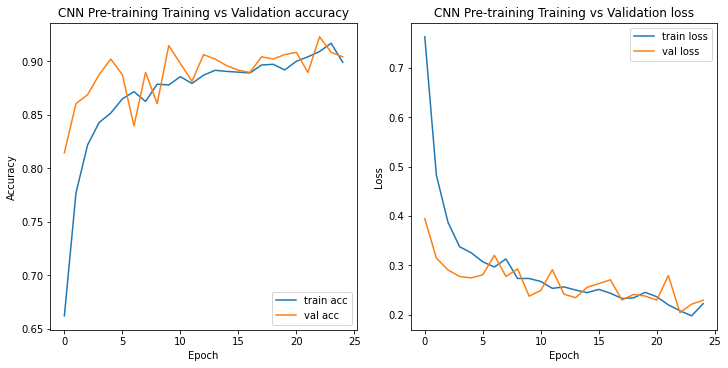

In [ ]:
# Plot training vs loss plots
plot_accuracy_loss(cnn_healnet_history.history, 'CNN Pre-training')

In [ ]:
# Save the healnet and encoder model weights
cnn_encoder.save_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CNN-Encoder/')
cnn_healnet.save_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CNN-Healnet/')

Load the saved model weights.

In [ ]:
cnn_encoder.load_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CNN-Encoder/')
cnn_healnet.load_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CNN-Healnet/')

## Dataset Loading

Load the image dataset (Single Images)

In [8]:
!ls gdrive/MyDrive/CSE247\ -\ Projects\ in\ AI/Review/Dataset/

 Circle_Cropped_images
 Circle_Cropped_images_Sid
'Cropped images'
 Cropped_Images_Wound_Stage_Probabilities_Cleaned_No_Ties.csv
 Cropped_Images_Wound_Stage_Probabilities.csv
 Spatially_Cropped_images
 Spatially_Cropped_images_split
 Updated_Cropped_Images_Wound_Stage_Probabilities.csv
 Wound_images


Load the image labels from the CSV

In [9]:
# Read the csv file that contains labels
df = pd.read_csv("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Cropped_Images_Wound_Stage_Probabilities_Cleaned_No_Ties.csv", index_col='Image')
df.head()

,hemostasis,inflammatory,proliferative,maturation
Image,,,,
Day 8_A8-4-L.png,0.0,0.0,1.00,0.00
Day 4_A8-3-R.png,0.0,1.0,0.00,0.00
Day 14_Y8-4-L.png,0.0,0.0,0.00,1.00
Day 7_Y8-4-L.png,0.0,0.0,0.75,0.25
Day 2_A8-1-L.png,0.0,1.0,0.00,0.00


In [10]:
# Statistical data of the labels
df.describe()

,hemostasis,inflammatory,proliferative,maturation
count,255.000000,255.000000,255.000000,255.000000
mean,0.190845,0.217787,0.335808,0.255560
std,0.374733,0.369257,0.426191,0.410838
min,0.000000,0.000000,0.000000,0.000000
25%,0.000000,0.000000,0.000000,0.000000
50%,0.000000,0.000000,0.000000,0.000000
75%,0.000000,0.428571,0.732143,0.500000
max,1.000000,1.000000,1.000000,1.000000


In [11]:
# Columns in the csv
df.columns

Index(['hemostasis', 'inflammatory', 'proliferative', 'maturation'], dtype='object')

In [12]:
# Thresholding values and getting classes for individual image
df[['hemostasis','inflammatory','proliferative','maturation']] = df[['hemostasis','inflammatory','proliferative','maturation']].apply(pd.to_numeric)
single_labels = pd.DataFrame(df.idxmax(axis=1), columns=['stage'])
single_labels.head()

,stage
Image,
Day 8_A8-4-L.png,proliferative
Day 4_A8-3-R.png,inflammatory
Day 14_Y8-4-L.png,maturation
Day 7_Y8-4-L.png,proliferative
Day 2_A8-1-L.png,inflammatory


In [13]:
# One-hot encoding of the labels
single_labels = pd.get_dummies(single_labels.stage)
single_labels.head()

,hemostasis,inflammatory,maturation,proliferative
Image,,,,
Day 8_A8-4-L.png,0,0,0,1
Day 4_A8-3-R.png,0,1,0,0
Day 14_Y8-4-L.png,0,0,1,0
Day 7_Y8-4-L.png,0,0,0,1
Day 2_A8-1-L.png,0,1,0,0


Image Loading

In [ ]:
# Path to the training dataset
image_dir = "/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/"
image_list = [os.path.join(image_dir, file) for file in os.listdir(image_dir)]

mice_val_list = ['_A8-5-R','_Y8-4-L']
mice_test_list = ['_A8-5-L','_Y8-4-R']
train_img_list = []
val_img_list = []
test_img_list = []

for i, image in enumerate(image_list):
  flag = False
  for mice in mice_val_list:
    if(mice in image):
      val_img_list.append(image)
      flag = True
  for mice in mice_test_list:
    if(mice in image):
      test_img_list.append(image)
      flag = True
  if(not flag):
    train_img_list.append(image)

print("Train images:", len(train_img_list))
print("Val images:", len(val_img_list))
print("Test images:", len(test_img_list))

Train images: 191
Val images: 32
Test images: 32


In [ ]:
def pil_loader(path, target_image_shape=(224,224)):
  """
  Load individual image into memory
  
  Parameters
  ----------
  path
    The absolute path to load an image
  target_shaepe : tuple
    The dimensions of the output image

  Returns
  -------
  img
    The image loaded in the memory
  """
  with open(path, 'rb') as f:
    img = PIL.Image.open(f)
    img = img.convert('RGB')
    img = np.array(img)
    img = cv2.resize(img, target_image_shape)

    return img

def load_image_dataset(image_list):
  """
  Load the single image dataset
  
  Parameters
  ----------
  image_list
    A list of images to load

  Returns
  -------
  images
    The stack of images loaded into memory
  labels
    The labels for the images
  """

  images = []
  labels = []

  for image in image_list:
    images += [pil_loader(image)]
    image_name = image.split('/')[-1]
    labels.append(list(single_labels.iloc[single_labels.index.get_loc(image_name)].to_dict().values()))

  return np.array(images), np.array(labels)

In [ ]:
# Load single image dataset and labels
single_train_images, single_train_labels = load_image_dataset(train_img_list)
single_val_images, single_val_labels = load_image_dataset(val_img_list)
single_test_images, single_test_labels = load_image_dataset(test_img_list)

print(single_train_images.shape, single_train_labels.shape)

(191, 224, 224, 3) (191, 4)


[1 0 0 0]


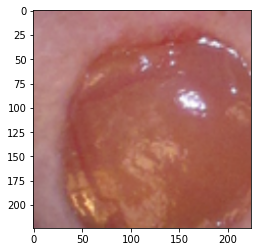

In [ ]:
# Display one image from the training set
idx = 1
plt.imshow(single_train_images[idx])
print(single_train_labels[idx])

## Clustering

In [ ]:
# Get embeddings from the pre-trained temporal encoder
train_embeddings = cnn_encoder.predict(single_train_images)
val_embeddings = cnn_encoder.predict(single_val_images)
test_embeddings = cnn_encoder.predict(single_test_images)

In [ ]:
# Fit K-means Clusters on train embeddings
kmeans = KMeans(n_clusters=4, random_state=0).fit(train_embeddings)
print("Predicted train labels:", kmeans.labels_)

# Cluster validation embeddings
print("Predicted validation labels:", kmeans.predict(val_embeddings))

# Cluster test embeddings
print("Predicted test labels:", kmeans.predict(test_embeddings))

Predicted train labels: [1 1 1 1 1 1 1 2 2 1 1 2 1 2 1 2 1 2 2 0 2 2 0 2 2 2 2 3 2 2 2 0 2 0 0 0 0
 2 2 0 2 2 2 0 0 0 2 0 2 2 2 0 2 0 2 0 0 0 0 2 0 0 0 0 0 2 0 0 0 0 0 0 0 0
 2 2 0 1 1 1 1 1 0 1 0 1 0 0 1 3 1 1 1 1 1 1 3 3 1 1 3 1 1 1 1 1 1 1 1 1 1
 1 3 1 3 1 3 3 1 1 3 1 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 3 1 3 3
 3 1 2 3 2 3 3 3 2 3 3 2 3 3 2 3 3 0 2 2 3 2 2 2 2 3 2 3 2 2 2 2 3 3 3 2 2
 2 2 2 0 0 0]
Predicted validation labels: [1 2 1 2 2 0 0 2 0 0 0 0 0 1 0 1 1 3 1 3 3 3 3 3 3 2 3 3 2 2 2 0]
Predicted test labels: [1 2 1 2 0 2 2 0 2 0 0 0 0 1 0 1 1 1 1 3 1 3 3 3 3 3 3 3 3 2 2 2]


In [ ]:
# Produce labels from the embeddings
k_train_labels = kmeans.predict(train_embeddings)
k_val_labels = kmeans.predict(val_embeddings)
k_test_labels = kmeans.predict(test_embeddings)

print("Count of labels:", len(kmeans.labels_))

Count of labels: 191


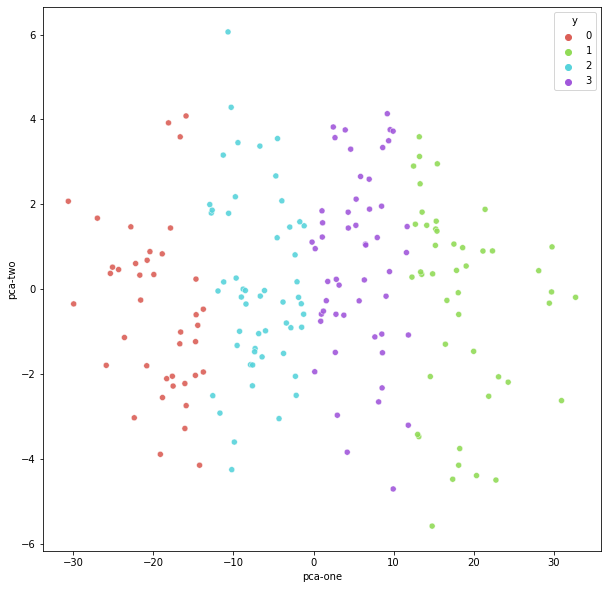

In [ ]:
# Fit PCA on Test embeddings
pca = decomposition.PCA(n_components=2)
pca.fit(train_embeddings)

# Plot train data PCA
X = pca.transform(train_embeddings)
df = pd.DataFrame(X,columns=['pca-one', 'pca-two'])
df['y'] = kmeans.labels_
plt.figure(figsize=(10,10));
sns.scatterplot(
    x="pca-one", y="pca-two",
    hue="y",
    palette=sns.color_palette("hls", 4),
    data=df,
    legend="full",
    alpha=0.9
)

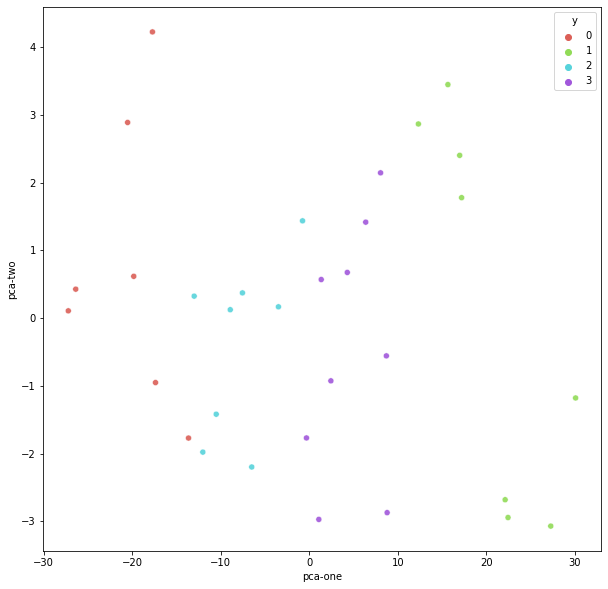

In [ ]:
# Plot test data PCA
X = pca.transform(test_embeddings)
df = pd.DataFrame(X,columns=['pca-one', 'pca-two'])
df['y'] = kmeans.predict(test_embeddings)
plt.figure(figsize=(10,10))
sns.scatterplot(
    x="pca-one", y="pca-two",
    hue="y",
    palette=sns.color_palette("hls", 4),
    data=df,
    legend="full",
    alpha=0.9
)

## Wound Stage Classification (CNN)

Augment the dataset

In [ ]:
def normalize_image(image):
  """
  Normalize the input image
  
  Parameters
  ----------
  image
    A image from the dataset
  
  Returns
  -------
  image
    The normalized image
  """
  image -= image.min()
  image = np.divide(image, image.max(), casting="unsafe")
  image *= 255
  
  return image

# Define train image data generator
train_datagen = ImageDataGenerator(
    preprocessing_function=normalize_image,
    horizontal_flip=True,
    vertical_flip=True,
    rotation_range=30,
    fill_mode="nearest"
)

# Define validation image data generator
val_datagen = ImageDataGenerator(
    preprocessing_function=normalize_image,
    horizontal_flip=True,
    vertical_flip=True,
    rotation_range=30,
    fill_mode="nearest"
)

Build the classification model

In [ ]:
def create_CNN_wound_classifier(input_shape=(224, 224, 3)):
  """
  Create the CNN wound classification model
  
  Parameters
  ----------
  input_shape : tuple
    The shape of the input images
  
  Returns
  -------
  cnn_encoder
    The cnn temporal encoder model
  cnn_wound_classifier
    The wound classification model
  """
  cnn_encoder = create_CNN_encoder()
  cnn_encoder.load_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CNN-Encoder/')

  for layer in cnn_encoder.layers[:-7]:
    layer.trainable = False

  input_layer = cnn_encoder.input
  encoder = cnn_encoder.output
  
  output_layer = layers.Dense(4, activation="softmax", name='dense_3')(encoder)

  classification_model = Model(inputs=input_layer, outputs=output_layer)

  return cnn_encoder, classification_model

cnn_encoder, cnn_wound_classifier = create_CNN_wound_classifier()

input_1 True
conv_1 True
maxpool_1 True
batchnorm_1 True
dropout_1 True
conv_2 True
maxpool_2 True
batchnorm_2 True
dropout_2 True
conv_3 True
maxpool_3 True
batchnorm_3 True
dropout_3 True
flatten_1 True
embedding_1 True
dense_2 True
dropout_4 True
dense_3 True
Model: "temporal_encoder"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv_1 (Conv2D)             (None, 112, 112, 32)      896       
                                                                 
 maxpool_1 (MaxPooling2D)    (None, 56, 56, 32)        0         
                                                                 
 batchnorm_1 (BatchNormaliza  (None, 56, 56, 32)       128       
 tion)                                                           
                                                   

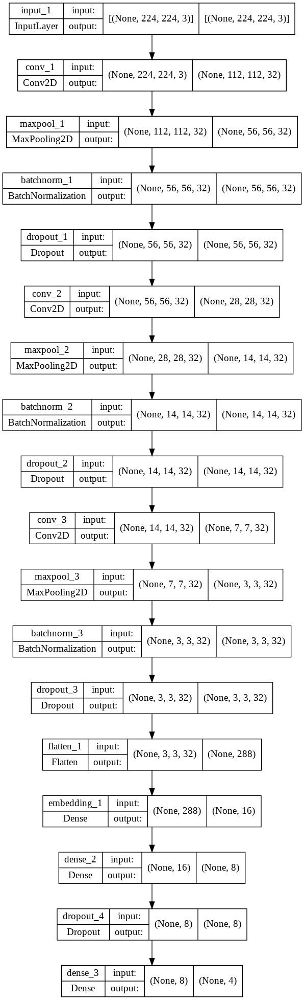

In [ ]:
# Print CNN Wound classifier summary
for layer in cnn_wound_classifier.layers:
  print(layer.name, layer.trainable)

cnn_encoder.summary()
utils.plot_model(cnn_wound_classifier, show_shapes=True)

In [ ]:
batch_size = 32

# Compile the model
opt = tf.keras.optimizers.Adam(learning_rate=0.001)
cnn_wound_classifier.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
cls_model_history = cnn_wound_classifier.fit(
                                train_datagen.flow(single_train_images, single_train_labels),
                                validation_data=val_datagen.flow(single_val_images, single_val_labels),
                                batch_size=batch_size,
                                epochs=100,
                                verbose=1
                                )

Epoch 1/100
6/6 [==============================] - 1s 78ms/step - loss: 2.0265 - accuracy: 0.3717 - val_loss: 2.2733 - val_accuracy: 0.2188
Epoch 2/100
6/6 [==============================] - 0s 22ms/step - loss: 1.4681 - accuracy: 0.4660 - val_loss: 1.4010 - val_accuracy: 0.3750
Epoch 3/100
6/6 [==============================] - 0s 20ms/step - loss: 1.3459 - accuracy: 0.4188 - val_loss: 1.2581 - val_accuracy: 0.3750
Epoch 4/100
6/6 [==============================] - 0s 18ms/step - loss: 1.1716 - accuracy: 0.4974 - val_loss: 1.1737 - val_accuracy: 0.4062
Epoch 5/100
6/6 [==============================] - 0s 18ms/step - loss: 1.0853 - accuracy: 0.4503 - val_loss: 1.0922 - val_accuracy: 0.4375
Epoch 6/100
6/6 [==============================] - 0s 20ms/step - loss: 1.0412 - accuracy: 0.4817 - val_loss: 1.3287 - val_accuracy: 0.4062
Epoch 7/100
6/6 [==============================] - 0s 18ms/step - loss: 0.9800 - accuracy: 0.5026 - val_loss: 1.3111 - val_accuracy: 0.4062
Epoch 8/100
6/6 [===

In [ ]:
# Print the test accuracy
loss, acc = cnn_wound_classifier.evaluate(single_test_images, single_test_labels, verbose=2)
print("Accuracy: {:5.2f}%".format(100 * acc))

1/1 - 0s - loss: 0.5582 - accuracy: 0.8125 - 20ms/epoch - 20ms/step
Accuracy: 81.25%


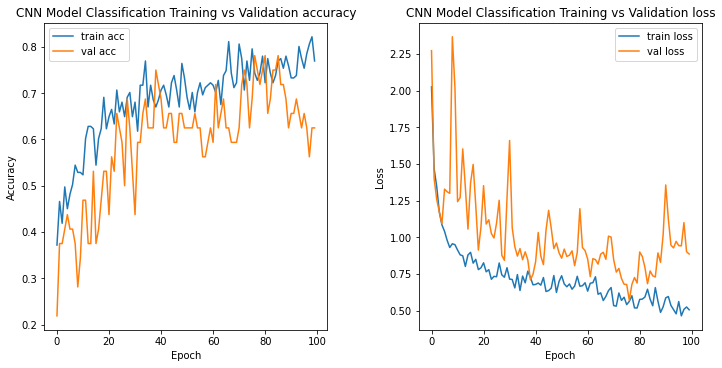

In [ ]:
# Plot the accuracy vs loss graphs
plot_accuracy_loss(cls_model_history.history, 'CNN Model Classification')

In [ ]:
# Save model weights
cnn_wound_classifier.save_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CNN-Wound-Classifier/')

In [ ]:
# Load model weights
cnn_wound_classifier.load_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CNN-Wound-Classifier/')

## Visualize feature maps (CNN)

In [ ]:
# Print the layers of the cnn wound classifier
for i, layer in enumerate(cnn_wound_classifier.layers):
  print(i, layer.name)

0 input_1
1 conv_1
2 maxpool_1
3 batchnorm_1
4 dropout_1
5 conv_2
6 maxpool_2
7 batchnorm_2
8 dropout_2
9 conv_3
10 maxpool_3
11 batchnorm_3
12 dropout_3
13 flatten_1
14 embedding_1
15 dense_3


In [ ]:
# Create the visualization model
successive_outputs = []
successive_layer_names = []

for layer in cnn_wound_classifier.layers:
  if 'conv' in layer.name:
    successive_outputs.append(layer.output)
    successive_layer_names.append(layer.name)

print(successive_outputs)

visualization_model = Model(inputs=cnn_wound_classifier.input, outputs=successive_outputs)

[<KerasTensor: shape=(None, 112, 112, 32) dtype=float32 (created by layer 'conv_1')>, <KerasTensor: shape=(None, 28, 28, 32) dtype=float32 (created by layer 'conv_2')>, <KerasTensor: shape=(None, 7, 7, 32) dtype=float32 (created by layer 'conv_3')>]


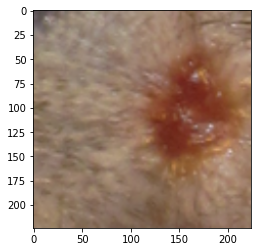

In [ ]:
# Display one image from the training set
img = single_train_images[35]
plt.imshow(img)

In [ ]:
def plot_feature_maps(img, img_i, path):
  """
  Display the feature maps from all the layers
  
  Parameters
  ----------
  img
    The image to be displayed
  img_i
    The index of the image to be displayed
  path
    The path of the image to be displayed
  """
  
  x = img_to_array(img)
  x = x.reshape((1,) + x.shape)

  path_i = os.path.join(path, str(img_i))
  if not os.path.exists(path_i):
    os.mkdir(path_i)

  successive_feature_maps = visualization_model.predict(x)

  layer_names = successive_layer_names
  for layer_name, feature_map in zip(layer_names, successive_feature_maps):
    if (len(feature_map.shape) == 4):
      n_features = feature_map.shape[-1]  # number of features in the feature map
      size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)

      # We will tile our images in this matrix
      display_grid = np.zeros((size, size * n_features))
      
      # Postprocess the feature to be visually palatable
      for i in range(n_features):
        x  = feature_map[0, :, :, i]
        x -= x.mean()
        x = np.divide(x, x.std ())
        x *=  64
        x += 128
        x  = np.clip(x, 0, 255).astype('uint8')
        # Tile each filter into a horizontal grid
        display_grid[:, i * size : (i + 1) * size] = x
      
      # Display the grid
      scale = 20. / n_features
      plt.figure( figsize=(scale * n_features, scale))
      plt.title ( layer_name )
      plt.grid  ( False )
      plt.imshow( display_grid, aspect='auto', cmap='viridis' )
      plt.savefig(os.path.join(path_i, layer_name))

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


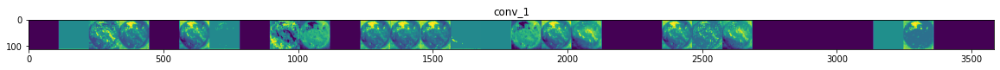

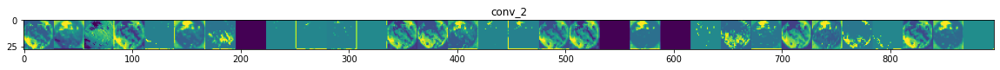

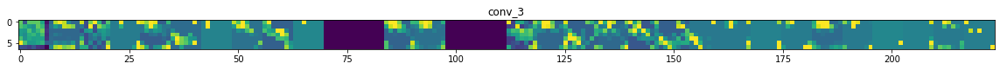

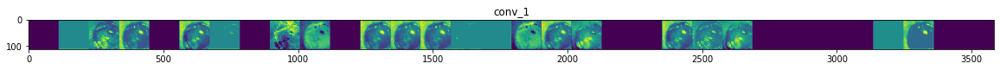

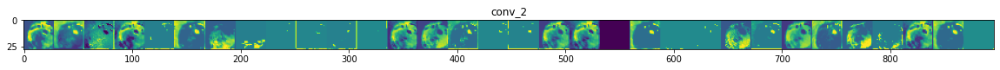

...

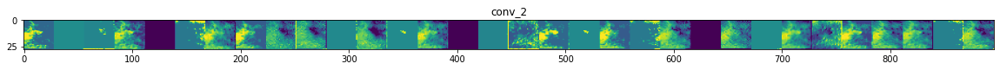

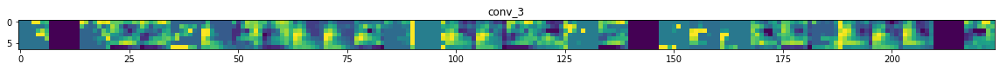

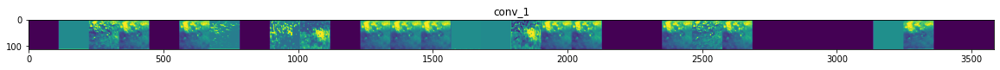

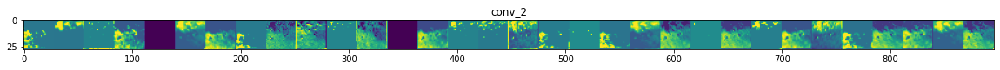

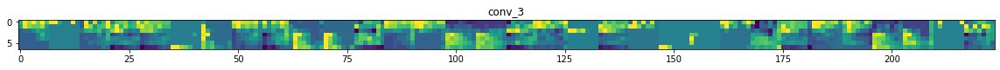

In [ ]:
# Display fearture maps for all the training images
for i in range(len(single_train_images)):
  plot_feature_maps(single_train_images[i], i, '/content/gdrive/MyDrive/CSE247 - Projects in AI/Visualizations/CNN/Train/')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


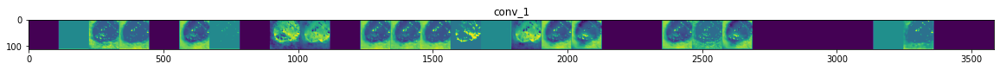

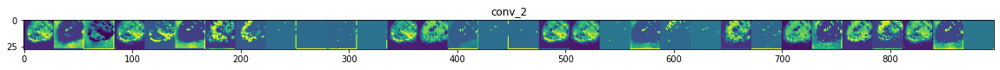

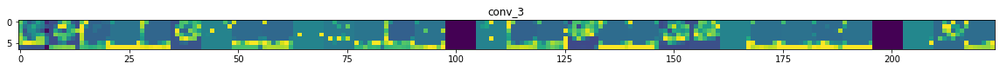

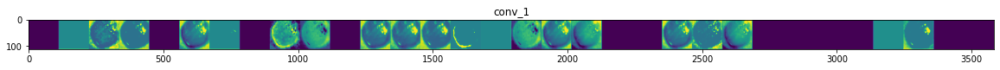

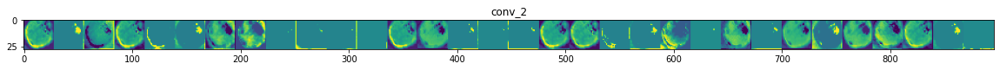

...

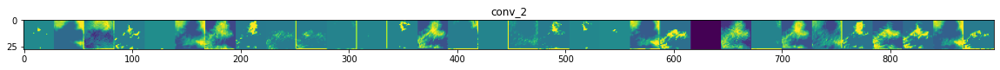

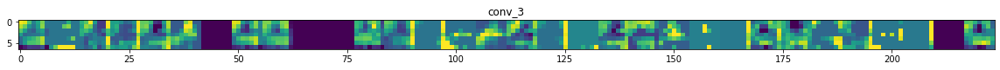

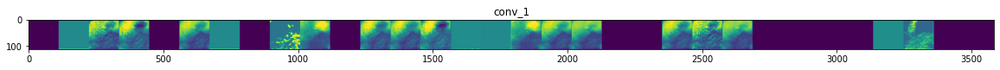

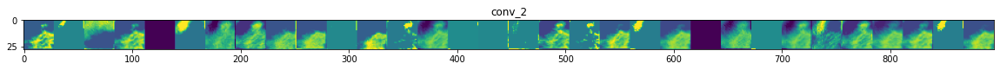

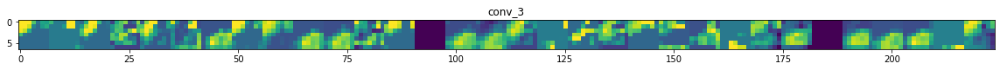

In [ ]:
# Display feature maps for all the val images
for i in range(len(single_val_images)):
  plot_feature_maps(single_val_images[i], i, '/content/gdrive/MyDrive/CSE247 - Projects in AI/Visualizations/CNN/Val/')

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:26: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:35: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


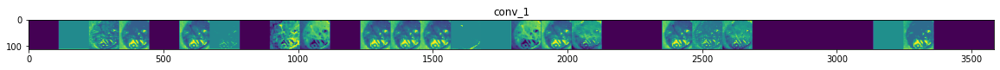

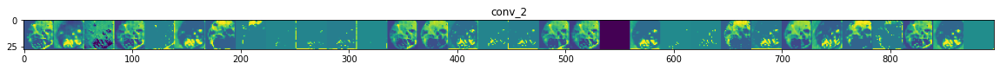

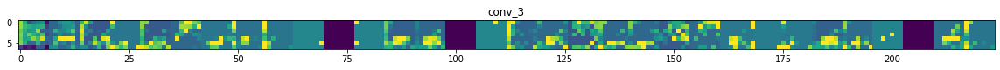

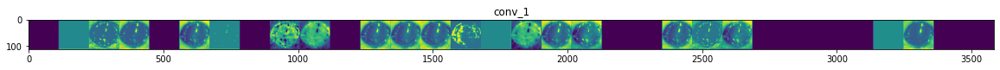

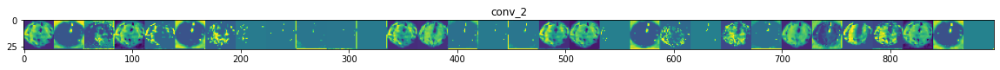

...

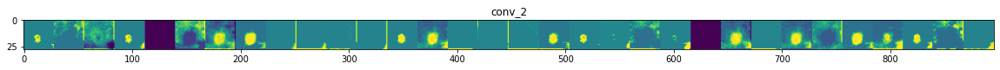

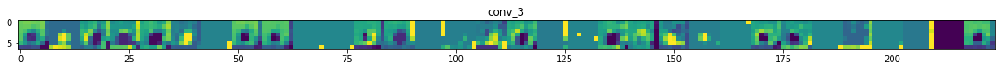

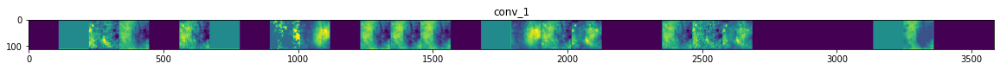

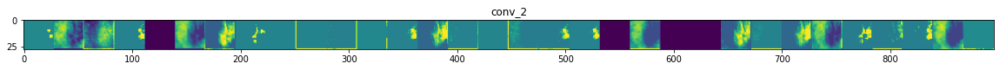

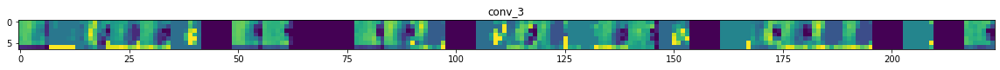

In [ ]:
# Display feature maps for all the test images
for i in range(len(single_test_images)):
  plot_feature_maps(single_test_images[i], i, '/content/gdrive/MyDrive/CSE247 - Projects in AI/Visualizations/CNN/Test/')

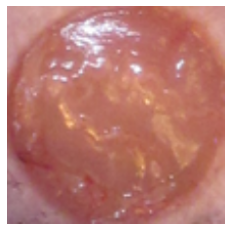

In [ ]:
# Display one train image
plt.axis('off')
plt.imshow(single_train_images[0])

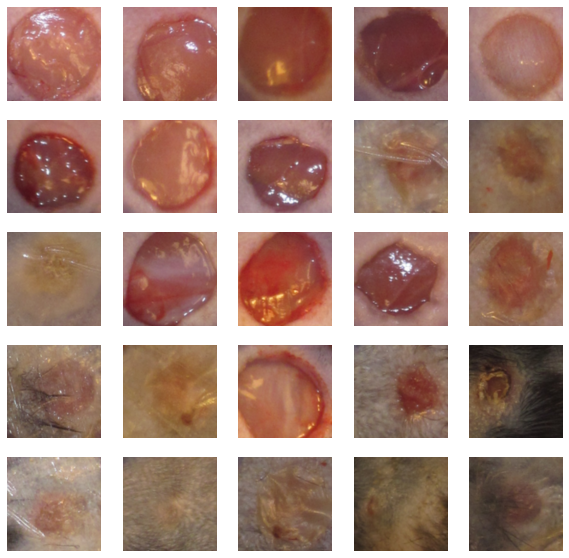

In [ ]:
# Display a few train image samples
plt.figure(figsize=(10, 10))
for n in range(25):
    ax = plt.subplot(5, 5, n+1)
    plt.imshow(single_train_images[n].squeeze(), cmap="binary")
    plt.axis("off")

Display the heatmaps for all the layers.

In [ ]:
def preprocess(img):
  return np.expand_dims(img, 0)

In [ ]:
def get_activations_at(input_image, i):
  # index the layer 
  out_layer = cnn_wound_classifier.layers[i]
  
  # change the output of the model 
  model = tf.keras.models.Model(inputs = cnn_wound_classifier.inputs, outputs = out_layer.output)
  
  # return the activations
  return model.predict(input_image)

In [ ]:
def postprocess_activations(activations):

  # using the approach in https://arxiv.org/abs/1612.03928
  output = np.abs(activations)
  output = np.sum(output, axis = -1).squeeze()

  # resize and convert to image 
  output = cv2.resize(output, (224, 224))
  output /= output.max()
  output *= 255
  return 255 - output.astype('uint8')

In [ ]:
def apply_heatmap(weights, img):
  # generate heat maps 
  heatmap = cv2.applyColorMap(weights, cv2.COLORMAP_JET)
  heatmap = cv2.addWeighted(heatmap, 0.7, img, 0.3, 0)
  return heatmap

In [ ]:
def plot_heatmaps(rng):
  level_maps = None
  
  # given a range of indices generate the heat maps 
  for i in rng:
    activations = get_activations_at(input_image, i)
    weights = postprocess_activations(activations)
    heatmap = apply_heatmap(weights, img)
    if level_maps is None:
      level_maps = heatmap
    else:
      level_maps = np.concatenate([level_maps, heatmap], axis = 1)
  plt.figure(figsize=(25, 25))
  plt.axis('off')
  ax = plt.imshow(level_maps)


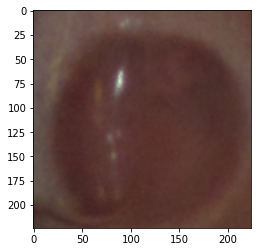

In [ ]:
# Display the original image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 1_A8-4-L.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'maxpool_3', 'batchnorm_3', 'dropout_3', 'flatten_1', 'embedding_1', 'dense_3']


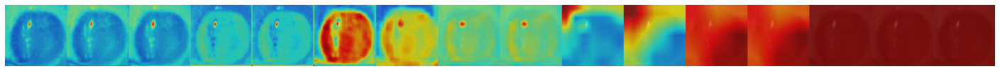

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(cnn_wound_classifier.layers)))
print([layer.name for layer in cnn_wound_classifier.layers])

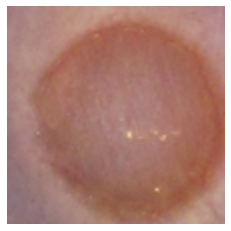

In [ ]:
# Display the original image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-1-L.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
plt.axis('off')
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'maxpool_3', 'batchnorm_3', 'dropout_3', 'flatten_1', 'embedding_1', 'dense_3']


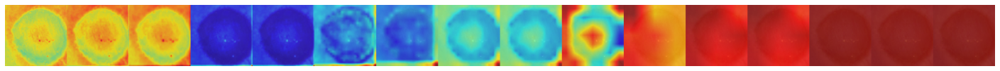

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(cnn_wound_classifier.layers)))
print([layer.name for layer in cnn_wound_classifier.layers])

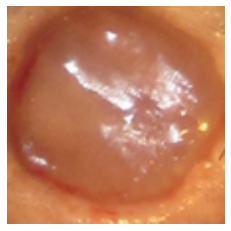

In [ ]:
# Display the original image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 2_Y8-3-L.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
plt.axis('off')
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'maxpool_3', 'batchnorm_3', 'dropout_3', 'flatten_1', 'embedding_1', 'dense_3']


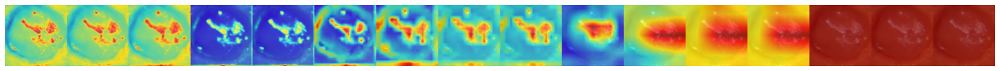

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(cnn_wound_classifier.layers)))
print([layer.name for layer in cnn_wound_classifier.layers])

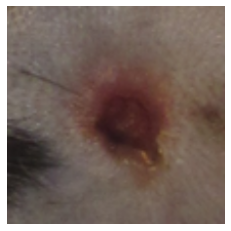

In [ ]:
# Display the original image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 9_Y8-1-L.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
plt.axis('off')
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'maxpool_3', 'batchnorm_3', 'dropout_3', 'flatten_1', 'embedding_1', 'dense_3']


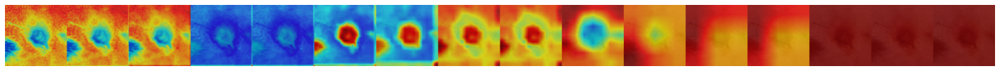

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(cnn_wound_classifier.layers)))
print([layer.name for layer in cnn_wound_classifier.layers])

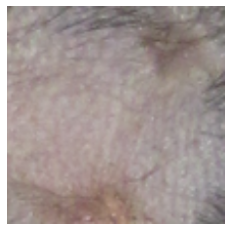

In [ ]:
# Display the original image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 15_A8-5-R.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
plt.axis('off')
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'maxpool_3', 'batchnorm_3', 'dropout_3', 'flatten_1', 'embedding_1', 'dense_3']


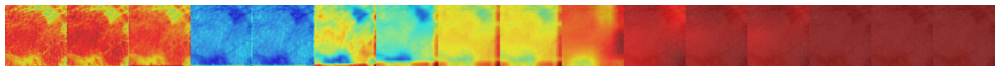

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(cnn_wound_classifier.layers)))
print([layer.name for layer in cnn_wound_classifier.layers])

## Pre-training (CLAN)

In [ ]:
def CLCA_2(middle_layer, top_layer, intermediate_dim = None):
  """
  Create Cross-Layer Context Attention module
  
  Parameters
  ----------
  middle_layer
    The middle layer of the model
  top_layer
    The top layer of the model
  intermediate_dim
    The intermediate dimension of the matrices
  
  Returns
  -------
  ls
    The output of the CLCA module
  """
  x = layers.UpSampling2D(size=(4,4), name='upsample_1')(top_layer)
  x = layers.Conv2D(64, kernel_size=3, activation='relu', padding='same', name='conv_8')(x)

  z = layers.add([middle_layer, x], name='add_15')
  ls = non_local_block(z, middle_layer)

  return ls

def CLSA_2(middle_layer, top_layer):
  """
  Create Cross-Layer Spatial Attention module
  
  Parameters
  ----------
  middle_layer
    The middle layer of the model
  top_layer
    The top layer of the model
  
  Returns
  -------
  output_layer
    The output of the CLSA module
  """
  x1 = layers.AveragePooling2D(pool_size=(2,2), name='avg_1')(middle_layer)
  x2 = layers.MaxPooling2D(pool_size=(2,2))(middle_layer)

  x = layers.Concatenate(name='concat_1')([x1, x2])

  x = layers.Conv2D(64, kernel_size=3, activation='relu', padding='same', name='conv_9')(x)
  x = layers.MaxPooling2D(pool_size=(2,2), name='maxpool_4')(x)
  
  output_layer = layers.Multiply(name='multiply_1')([x, top_layer])

  return output_layer

In [ ]:
def create_crosslayer_model(input_shape=(224,224,3)):
  """
  Create Cross-Layer model
  
  Parameters
  ----------
  input_shape
    The shape of the input image
  
  Returns
  -------
  clan
    The cross-layer attention model
  """
  # Backbone CNN model
  input_layer = layers.Input(shape=input_shape, name="input_1")

  conv_1 = layers.Conv2D(64, kernel_size=3, strides=(2,2), activation='relu', padding='same', name='conv_1')(input_layer)
  x = layers.MaxPooling2D(pool_size=(2,2), name='maxpool_1')(conv_1)
  x = layers.BatchNormalization(name='batchnorm_1')(x)
  x = layers.Dropout(0.5, name='dropout_1')(x)
  
  conv_2 = layers.Conv2D(64, kernel_size=3, strides=(2,2), activation='relu', padding='same', name='conv_2')(x)
  x = layers.MaxPooling2D(pool_size=(2,2), name='maxpool_2')(conv_2)
  x = layers.BatchNormalization(name='batchnorm_2')(x)
  x = layers.Dropout(0.5, name='dropout_2')(x)
  
  conv_3 = layers.Conv2D(64, kernel_size=3, strides=(2,2), activation='relu', padding='same', name='conv_3')(x)
  x = layers.MaxPooling2D(pool_size=(2,2), name='maxpool_3')(conv_3)
  x = layers.BatchNormalization(name='batchnorm_3')(x)
  x = layers.Dropout(0.5, name='dropout_3')(x)

  x = layers.Flatten(name='flatten_1')(x)
  output_layer_1 = layers.Dense(16, activation='relu', name='embedding_1')(x)
  
  # CLCA 2
  clca_2 = CLCA_2(conv_2, conv_3)
  clca_2 = layers.BatchNormalization(name='batchnorm_4')(clca_2)
  clca_2 = layers.Dropout(0.5, name='dropout_4')(clca_2)
  x = layers.Flatten(name='flatten_2')(clca_2)
  output_layer_3 = layers.Dense(16, name='embedding_2')(x)
  
  # CLSA
  clsa_2 = CLSA_2(clca_2, conv_3)
  clsa_2 = layers.BatchNormalization(name='batchnorm_5')(clsa_2)
  clsa_2 = layers.Dropout(0.5, name='dropout_5')(clsa_2)
  x = layers.Flatten(name='flatten_3')(clsa_2)
  output_layer_4 = layers.Dense(16, name='embedding_3')(x)
  
  output_layer = layers.Concatenate(name='concat_2')([output_layer_1, output_layer_3, output_layer_4])
  
  clan = Model(inputs=input_layer, outputs=output_layer, name='clan')
  
  return clan


def create_clan_HealNet(input_shape=(224, 224, 3)):
  """
  Create Cross-Layer HealNet model
  
  Parameters
  ----------
  input_shape
    The shape of the input image
  
  Returns
  -------
  temporal_encoder
    The clan encoder
  clan_healnet
    The cross-layer attention healnet model
  """
  temporal_encoder = create_crosslayer_model()

  left_input = layers.Input(shape=input_shape, name="left_input")
  left_encoder = temporal_encoder(left_input)

  right_input = layers.Input(shape=input_shape, name="right_input")
  right_encoder = temporal_encoder(right_input)

  x = layers.Concatenate(name='concat_1')([left_encoder, right_encoder])
  output_layer = layers.Dense(1, activation="sigmoid", name='dense_1')(x)

  clan_healnet = Model(inputs=[left_input, right_input], outputs=output_layer, name='cnn_healnet')

  return temporal_encoder, clan_healnet

Batch size: None dim1: 28 dim2: 28 channels: 64
Model: "cnn_healnet"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 left_input (InputLayer)        [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 right_input (InputLayer)       [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 clan (Functional)              (None, 48)           1058096     ['left_input[0][0]',             
                                        

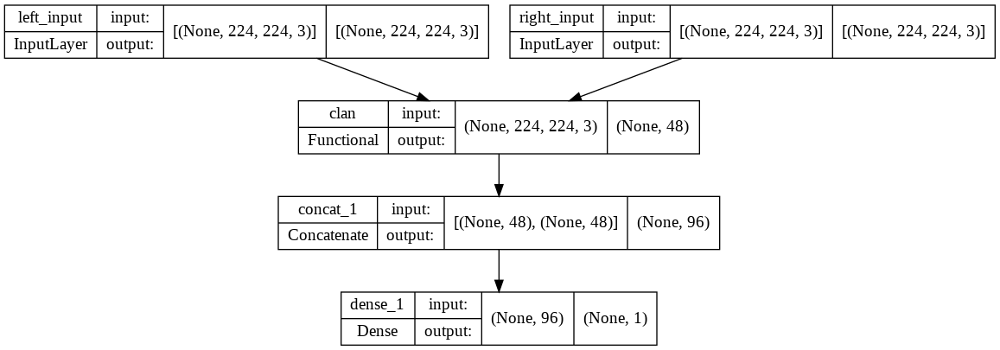

In [ ]:
# CLAN encoder and HealNet model summary
clan_encoder, clan_healnet = create_clan_HealNet()

clan_healnet.summary()
utils.plot_model(clan_healnet, show_layer_names=True, show_shapes=True)

Train the model

In [ ]:
def normalize_image(image):
  """
  Normalize the input image
  
  Parameters
  ----------
  image
    A image from the dataset
  
  Returns
  -------
  image
    The normalized image
  """
  image -= image.min()
  image = np.divide(image, image.max(), casting="unsafe")
  image *= 255
  
  return image

# Define train image data generator
train_datagen = ImageDataGenerator(
    preprocessing_function=normalize_image
)

# Define validation image data generator
val_datagen = ImageDataGenerator(
    preprocessing_function=normalize_image
)

In [ ]:
# Compile the model
clan_healnet.compile(optimizer='Adam', loss=['binary_crossentropy'], metrics=['accuracy'])

# Model training
clan_history = clan_healnet.fit(train_datagen.flow([left_train, right_train], labels_train),
                      validation_data=val_datagen.flow([left_val, right_val], labels_val),
                      batch_size=32,
                      epochs=25,
                      verbose=1)

# Print the test accuracy of the model
loss, acc = clan_healnet.evaluate([left_test, right_test], labels_test, verbose=2)
print("Accuracy: {:5.2f}%".format(100 * acc))

Epoch 1/25
90/90 [==============================] - 11s 76ms/step - loss: 2.7347 - accuracy: 0.6772 - val_loss: 0.5342 - val_accuracy: 0.7521
Epoch 2/25
90/90 [==============================] - 6s 66ms/step - loss: 1.1619 - accuracy: 0.7972 - val_loss: 0.7462 - val_accuracy: 0.7854
Epoch 3/25
90/90 [==============================] - 6s 67ms/step - loss: 0.6638 - accuracy: 0.8596 - val_loss: 0.8460 - val_accuracy: 0.8188
Epoch 4/25
90/90 [==============================] - 6s 68ms/step - loss: 0.5682 - accuracy: 0.8674 - val_loss: 0.6375 - val_accuracy: 0.8125
Epoch 5/25
90/90 [==============================] - 6s 68ms/step - loss: 0.3865 - accuracy: 0.8912 - val_loss: 0.5157 - val_accuracy: 0.8667
Epoch 6/25
90/90 [==============================] - 6s 67ms/step - loss: 0.2112 - accuracy: 0.9295 - val_loss: 0.6915 - val_accuracy: 0.8667
Epoch 7/25
90/90 [==============================] - 6s 67ms/step - loss: 0.2212 - accuracy: 0.9316 - val_loss: 0.6175 - val_accuracy: 0.8646
Epoch 8/25
9

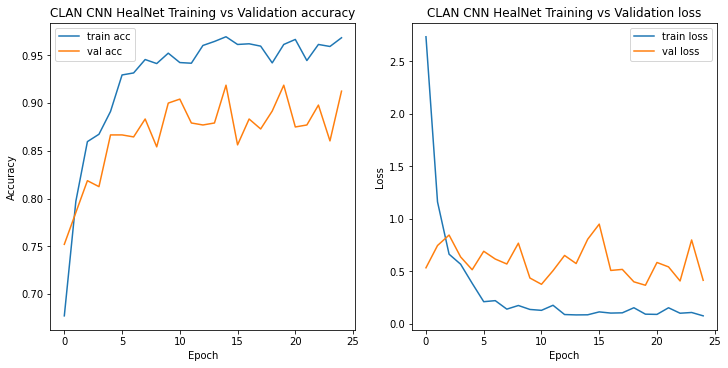

In [ ]:
# PLot the accuracy and loss graphs
plot_accuracy_loss(clan_history.history, 'CLAN CNN HealNet')

In [ ]:
# Save the model weights
clan_encoder.save_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CLAN-Encoder/')
clan_healnet.save_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CLAN-HealNet/')

In [ ]:
# Load the model weights
clan_healnet.load_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/TestN/Model/CLAN/')

## Wound Stage Classification (CLAN)

Augment the dataset

In [ ]:
def normalize_image(image):
  """
  Normalize the input image
  
  Parameters
  ----------
  image
    A image from the dataset
  
  Returns
  -------
  image
    The normalized image
  """
  image -= image.min()
  image = np.divide(image, image.max(), casting="unsafe")
  image *= 255
  
  return image

# Define train image data generator
train_datagen = ImageDataGenerator(
    preprocessing_function=normalize_image,
    horizontal_flip=True,
    vertical_flip=True,
    rotation_range=30,
    fill_mode="nearest"    
)

# Define validation image data generator
val_datagen = ImageDataGenerator(
    preprocessing_function=normalize_image,
    horizontal_flip=True,
    vertical_flip=True,
    rotation_range=30,
    fill_mode="nearest"
)

Build the classification model

In [ ]:
def create_CLAN_wound_classifier(input_shape=(224, 224, 3)):
  """
  Create the Cross-Layer attention wound classifier model
  
  Parameters
  ----------
  input_shape : tuple
    The shape of the input images
  
  Returns
  -------
  temporal_encoder
    The clan temporal encoder model
  classification_model
    The CLAN wound classification model
  """
  clan = create_crosslayer_model()
  clan.load_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CLAN-Encoder/')

  input_layer = clan.input
  encoder = clan.output
  
  output_layer = layers.Dense(4, activation="softmax", name='dense_5')(encoder)

  classification_model = Model(inputs=input_layer, outputs=output_layer)

  return clan, classification_model

Batch size: None dim1: 28 dim2: 28 channels: 64
input_1 True
conv_1 True
maxpool_1 True
batchnorm_1 True
dropout_1 True
conv_2 True
maxpool_2 True
batchnorm_2 True
dropout_2 True
conv_3 True
upsample_1 True
conv_8 True
add_15 True
conv_4 True
conv_5 True
reshape_1 True
reshape_2 True
dot_1 True
conv_6 True
lambda_1 True
reshape_3 True
dot_2 True
reshape_4 True
conv_7 True
add_25 True
batchnorm_4 True
dropout_4 True
avg_1 True
max_pooling2d_3 True
concat_1 True
conv_9 True
maxpool_4 True
maxpool_3 True
multiply_1 True
batchnorm_3 True
batchnorm_5 True
dropout_3 True
dropout_5 True
flatten_1 True
flatten_2 True
flatten_3 True
embedding_1 True
embedding_2 True
embedding_3 True
concat_2 True
dense_5 True
Model: "clan"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []           

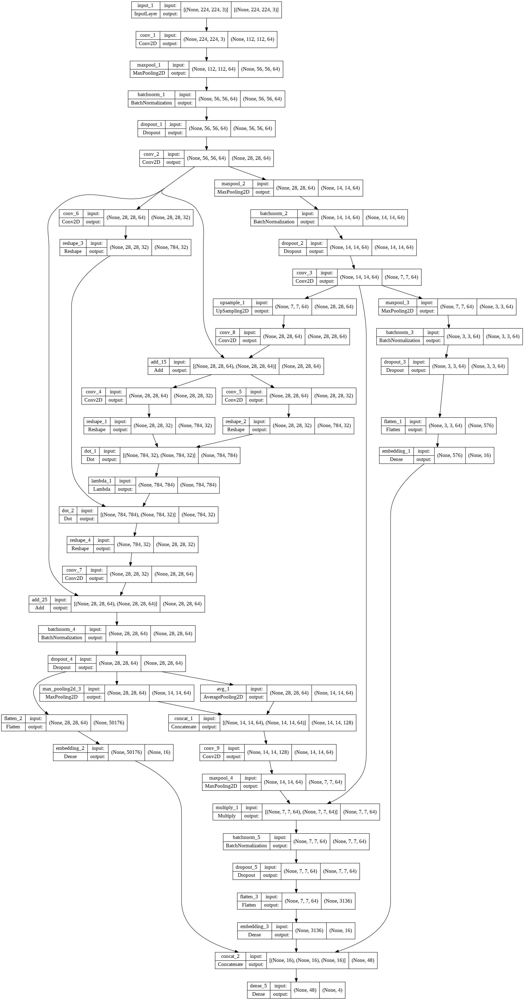

In [ ]:
clan_encoder, clan_wound_classifier = create_CLAN_wound_classifier()

for layer in clan_wound_classifier.layers:
  print(layer.name, layer.trainable)

clan_encoder.summary()
utils.plot_model(clan_wound_classifier, show_shapes=True)

In [ ]:
batch_size = 32

# Compile the model
opt = tf.keras.optimizers.Adam(learning_rate=0.0001)
clan_wound_classifier.compile(optimizer=opt, loss='categorical_crossentropy', metrics=['accuracy'])

# Train the model
clan_model_history = clan_wound_classifier.fit(
                                train_datagen.flow(single_train_images, single_train_labels),
                                validation_data=val_datagen.flow(single_val_images, single_val_labels),
                                batch_size=32,
                                epochs=50,
                                verbose=1
                                )

Epoch 1/50
6/6 [==============================] - 3s 205ms/step - loss: 8.1556 - accuracy: 0.1990 - val_loss: 7.0009 - val_accuracy: 0.4062
Epoch 2/50
6/6 [==============================] - 0s 45ms/step - loss: 5.2989 - accuracy: 0.3246 - val_loss: 7.2673 - val_accuracy: 0.4688
Epoch 3/50
6/6 [==============================] - 0s 44ms/step - loss: 3.8905 - accuracy: 0.4869 - val_loss: 6.8651 - val_accuracy: 0.5312
Epoch 4/50
6/6 [==============================] - 0s 45ms/step - loss: 2.4929 - accuracy: 0.5236 - val_loss: 6.3651 - val_accuracy: 0.5312
Epoch 5/50
6/6 [==============================] - 0s 42ms/step - loss: 1.9873 - accuracy: 0.5759 - val_loss: 5.6219 - val_accuracy: 0.5000
Epoch 6/50
6/6 [==============================] - 0s 47ms/step - loss: 2.5387 - accuracy: 0.5707 - val_loss: 4.4410 - val_accuracy: 0.5312
Epoch 7/50
6/6 [==============================] - 0s 44ms/step - loss: 1.7164 - accuracy: 0.6440 - val_loss: 3.2548 - val_accuracy: 0.5625
Epoch 8/50
6/6 [==========

In [ ]:
# Print test accuracy
loss, acc = clan_wound_classifier.evaluate(single_test_images, single_test_labels, verbose=2)
print("Accuracy: {:5.2f}%".format(100 * acc))

1/1 - 0s - loss: 1.5609 - accuracy: 0.7500 - 30ms/epoch - 30ms/step
Accuracy: 75.00%


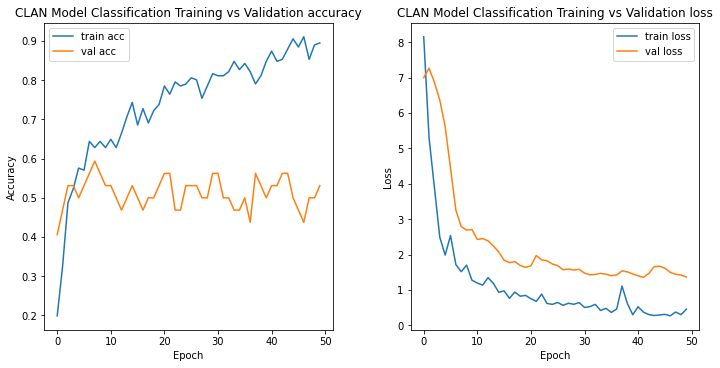

In [ ]:
# Plot the accuracy vs loss of the model
plot_accuracy_loss(clan_model_history.history, 'CLAN Model Classification')

In [ ]:
# Save the model weights
clan_wound_classifier.save_weights('/content/gdrive/MyDrive/CSE247 - Projects in AI/Saved/Model/CLAN-Wound-Classifier/')

## Visualize feature maps (CLAN)

In [ ]:
# Print the clan wound classifier layers
for i, layer in enumerate(clan_wound_classifier.layers):
  print(i, layer.name)

0 input_1
1 conv_1
2 maxpool_1
3 batchnorm_1
4 dropout_1
5 conv_2
6 maxpool_2
7 batchnorm_2
8 dropout_2
9 conv_3
10 upsample_1
11 conv_8
12 add_15
13 conv_4
14 conv_5
15 reshape_1
16 reshape_2
17 dot_1
18 conv_6
19 lambda_1
20 reshape_3
21 dot_2
22 reshape_4
23 conv_7
24 add_25
25 batchnorm_4
26 dropout_4
27 avg_1
28 max_pooling2d_3
29 concat_1
30 conv_9
31 maxpool_4
32 maxpool_3
33 multiply_1
34 batchnorm_3
35 batchnorm_5
36 dropout_3
37 dropout_5
38 flatten_1
39 flatten_2
40 flatten_3
41 embedding_1
42 embedding_2
43 embedding_3
44 concat_2
45 dense_5


In [ ]:
# Get the output layer of the wound classifier
successive_outputs = [layer.output for layer in clan_wound_classifier.layers]
print(successive_outputs)

# Create the visualization model
visualization_model = Model(inputs=clan_wound_classifier.input, outputs=successive_outputs)

[<KerasTensor: shape=(None, 224, 224, 3) dtype=float32 (created by layer 'input_1')>, <KerasTensor: shape=(None, 112, 112, 64) dtype=float32 (created by layer 'conv_1')>, <KerasTensor: shape=(None, 56, 56, 64) dtype=float32 (created by layer 'maxpool_1')>, <KerasTensor: shape=(None, 56, 56, 64) dtype=float32 (created by layer 'batchnorm_1')>, <KerasTensor: shape=(None, 56, 56, 64) dtype=float32 (created by layer 'dropout_1')>, <KerasTensor: shape=(None, 28, 28, 64) dtype=float32 (created by layer 'conv_2')>, <KerasTensor: shape=(None, 14, 14, 64) dtype=float32 (created by layer 'maxpool_2')>, <KerasTensor: shape=(None, 14, 14, 64) dtype=float32 (created by layer 'batchnorm_2')>, <KerasTensor: shape=(None, 14, 14, 64) dtype=float32 (created by layer 'dropout_2')>, <KerasTensor: shape=(None, 7, 7, 64) dtype=float32 (created by layer 'conv_3')>, <KerasTensor: shape=(None, 28, 28, 64) dtype=float32 (created by layer 'upsample_1')>, <KerasTensor: shape=(None, 28, 28, 64) dtype=float32 (crea

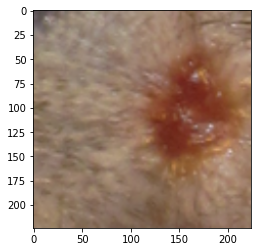

In [ ]:
# Display one image form the training set
img = single_train_images[35]
plt.imshow(img)

In [ ]:
def plot_feature_maps(img, path):
  """
  Plot the feature maps from all the layers
  
  Parameters
  ----------
  img : tuple
    The image to display
  path : str
    The path of the image
  """
  
  x = img_to_array(img)
  x = x.reshape((1,) + x.shape)

  successive_feature_maps = visualization_model.predict(x)
  layer_names = [layer.name for layer in clan_wound_classifier.layers]
  
  for layer_name, feature_map in zip(layer_names, successive_feature_maps):
    if (len(feature_map.shape) == 4):
      n_features = feature_map.shape[-1]  # number of features in the feature map
      size       = feature_map.shape[ 1]  # feature map shape (1, size, size, n_features)

      # We will tile our images in this matrix
      display_grid = np.zeros((size, size * n_features))
      
      # Postprocess the feature to be visually palatable
      for i in range(n_features):
        x  = feature_map[0, :, :, i]
        x -= x.mean()
        x = np.divide(x, x.std ())
        x *=  64
        x += 128
        x  = np.clip(x, 0, 255).astype('uint8')
        # Tile each filter into a horizontal grid
        display_grid[:, i * size : (i + 1) * size] = x
      
      # Display the grid
      scale = 50. / n_features
      plt.figure( figsize=(scale * n_features, scale))
      plt.title ( layer_name )
      plt.grid  ( False )
      plt.imshow( display_grid, aspect='auto', cmap='viridis' )

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:32: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


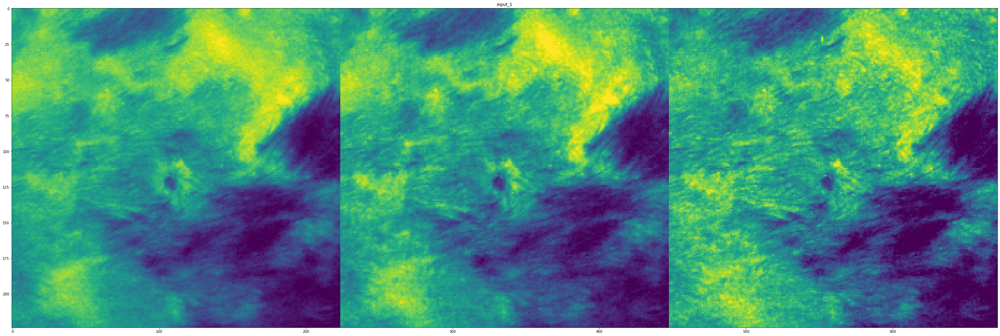

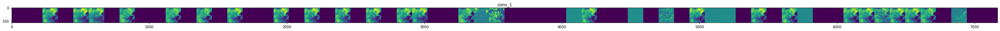

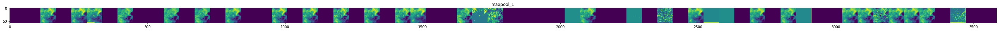

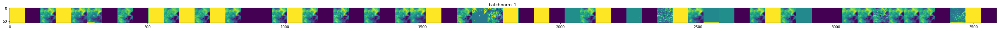

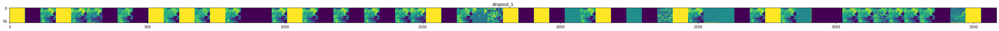

...

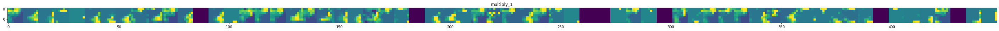

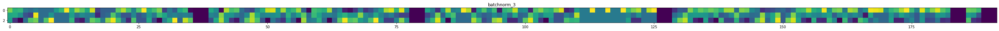

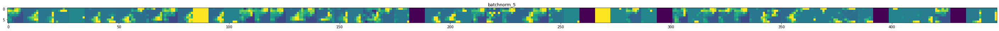

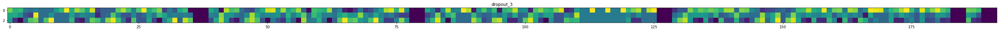

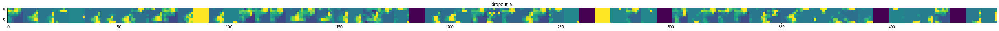

In [ ]:
# Plot feature maps of all the layers for one images
i = 35
plot_feature_maps(img, '/content/gdrive/MyDrive/CSE247 - Projects in AI/Visualizations/CLAN/Train/' + str(i) + '.png')

Display heatmaps for the input image.

In [ ]:
def preprocess(img):
  # expand the dimension
  return np.expand_dims(img, 0)

In [ ]:
def get_activations_at(input_image, i):
  # index the layer 
  out_layer = clan_wound_classifier.layers[i]
  
  # change the output of the model 
  model = tf.keras.models.Model(inputs = clan_wound_classifier.inputs, outputs = out_layer.output)
  
  # return the activations
  return model.predict(input_image)

In [ ]:
def postprocess_activations(activations):
  # using the approach in https://arxiv.org/abs/1612.03928
  output = np.abs(activations)
  output = np.sum(output, axis = -1).squeeze()

  # resize and convert to image 
  output = cv2.resize(output, (224, 224))
  output /= output.max()
  output *= 255
  return 255 - output.astype('uint8')

In [ ]:
def apply_heatmap(weights, img):
  # generate heat maps 
  heatmap = cv2.applyColorMap(weights, cv2.COLORMAP_JET)
  heatmap = cv2.addWeighted(heatmap, 0.7, img, 0.3, 0)
  return heatmap

In [ ]:
def plot_heatmaps(rng):
  """
  Display heatmaps for all the layers
  
  Parameters
  ----------
  rng : list
    The range of layers in the model
  """
  
  level_maps = None
  
  # given a range of indices generate the heat maps 
  for i in rng:
    activations = get_activations_at(input_image, i)
    weights = postprocess_activations(activations)
    heatmap = apply_heatmap(weights, img)
    if level_maps is None:
      level_maps = heatmap
    else:
      level_maps = np.concatenate([level_maps, heatmap], axis = 1)
  plt.figure(figsize=(25, 25))
  plt.axis('off')
  ax = plt.imshow(level_maps)

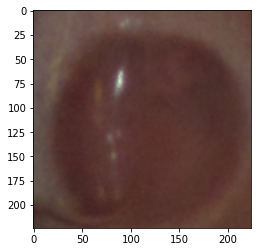

In [ ]:
# Display the original image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 1_A8-4-L.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'upsample_1', 'conv_8', 'add_15', 'conv_4', 'conv_5', 'reshape_1', 'reshape_2', 'dot_1', 'conv_6', 'lambda_1', 'reshape_3', 'dot_2', 'reshape_4', 'conv_7', 'add_25', 'batchnorm_4', 'dropout_4', 'avg_1', 'max_pooling2d_3', 'concat_1', 'conv_9', 'maxpool_4', 'maxpool_3', 'multiply_1', 'batchnorm_3', 'batchnorm_5', 'dropout_3', 'dropout_5', 'flatten_1', 'flatten_2', 'flatten_3', 'embedding_1', 'embedding_2', 'embedding_3', 'concat_2', 'dense_5']


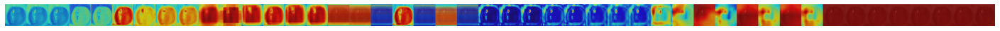

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(clan_wound_classifier.layers)))
print([layer.name for layer in clan_wound_classifier.layers])

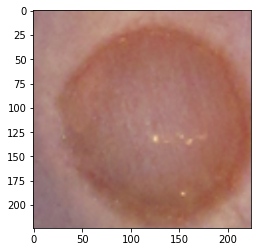

In [ ]:
# Display the original image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 0_A8-1-L.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'upsample_1', 'conv_8', 'add_15', 'conv_4', 'conv_5', 'reshape_1', 'reshape_2', 'dot_1', 'conv_6', 'lambda_1', 'reshape_3', 'dot_2', 'reshape_4', 'conv_7', 'add_25', 'batchnorm_4', 'dropout_4', 'avg_1', 'max_pooling2d_3', 'concat_1', 'conv_9', 'maxpool_4', 'maxpool_3']


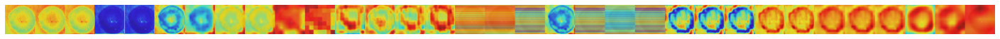

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(clan_wound_classifier.layers[:-13])))
print([layer.name for layer in clan_wound_classifier.layers[:-13]])

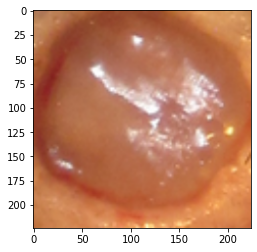

In [ ]:
# Display the original image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 2_Y8-3-L.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'upsample_1', 'conv_8', 'add_15', 'conv_4', 'conv_5', 'reshape_1', 'reshape_2', 'dot_1', 'conv_6', 'lambda_1', 'reshape_3', 'dot_2', 'reshape_4', 'conv_7', 'add_25', 'batchnorm_4', 'dropout_4', 'avg_1', 'max_pooling2d_3', 'concat_1', 'conv_9', 'maxpool_4', 'maxpool_3']


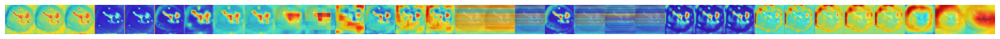

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(clan_wound_classifier.layers[:-13])))
print([layer.name for layer in clan_wound_classifier.layers[:-13]])

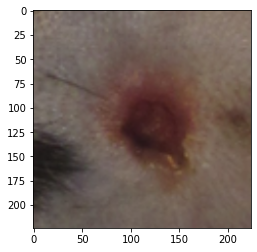

In [ ]:
# Display the orignal image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 9_Y8-1-L.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'upsample_1', 'conv_8', 'add_15', 'conv_4', 'conv_5', 'reshape_1', 'reshape_2', 'dot_1', 'conv_6', 'lambda_1', 'reshape_3', 'dot_2', 'reshape_4', 'conv_7', 'add_25', 'batchnorm_4', 'dropout_4', 'avg_1', 'max_pooling2d_3', 'concat_1', 'conv_9', 'maxpool_4', 'maxpool_3']


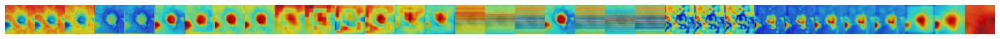

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(clan_wound_classifier.layers[:-13])))
print([layer.name for layer in clan_wound_classifier.layers[:-13]])

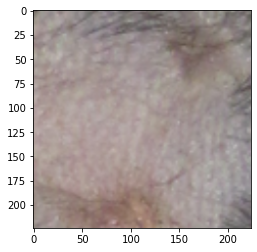

In [ ]:
# Display the original image
img = cv2.imread("/content/gdrive/MyDrive/CSE247 - Projects in AI/Review/Dataset/Circle_Cropped_images_Sid/Day 15_A8-5-R.png")[:,:,::-1]
img = cv2.resize(img, (224, 224))
ax = plt.imshow(img)

['input_1', 'conv_1', 'maxpool_1', 'batchnorm_1', 'dropout_1', 'conv_2', 'maxpool_2', 'batchnorm_2', 'dropout_2', 'conv_3', 'upsample_1', 'conv_8', 'add_15', 'conv_4', 'conv_5', 'reshape_1', 'reshape_2', 'dot_1', 'conv_6', 'lambda_1', 'reshape_3', 'dot_2', 'reshape_4', 'conv_7', 'add_25', 'batchnorm_4', 'dropout_4', 'avg_1', 'max_pooling2d_3', 'concat_1', 'conv_9', 'maxpool_4', 'maxpool_3']


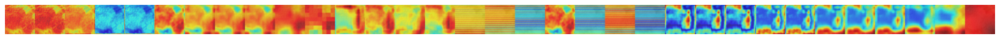

In [ ]:
# Display the heatmaps
input_image = preprocess(img)

plot_heatmaps(range(0, len(clan_wound_classifier.layers[:-13])))
print([layer.name for layer in clan_wound_classifier.layers[:-13]])